### SAT Visit Sweden National API

* [Issue #222](https://github.com/salgo60/Stockholm_Archipelago_Trail/issues/222)
* This Notebook [222_SAT_Visit_Sweden_national_API.ipynb]()

In [17]:
import time

from datetime import datetime

now = datetime.now()
timestamp = now.timestamp()

start_time = time.time()
print("Start:", datetime.now().strftime("%Y-%m-%d %H:%M:%S"))

Start: 2025-11-05 05:29:01


## pandas df

In [18]:
import requests
import pandas as pd
from tqdm import tqdm
import json
import os

# For the "full dump" script
FULL_CACHE_FILE = "visitsweden_full_dump.json"

# For the paged search script (the one you just posted)
SEARCH_CACHE_FILE = "visitsweden_search_all.json"

def fetch_visitsweden_data(force_refresh=False):
    # If cache exists and refresh not requested → load it
    if os.path.exists(FULL_CACHE_FILE) and not force_refresh:
        print(f"✅ Using cached VisitSweden data from {FULL_CACHE_FILE}")
        with open(FULL_CACHE_FILE, "r", encoding="utf-8") as f:
            all_records = json.load(f)
        return pd.DataFrame(all_records)

    # Otherwise, fetch fresh data from API
    print("🌍 Fetching fresh data from VisitSweden API...")

    base_url = (
        "https://data.visitsweden.com/store/search?"
        "type=solr&"
        "query=public:true+AND+("
        "rdfType:http%5C%3A%2F%2Fschema.org%2FFoodEstablishment+OR+"
        "rdfType:http%5C%3A%2F%2Fschema.org%2FEvent+OR+"
        "rdfType:http%5C%3A%2F%2Fschema.org%2FPlace+OR+"
        "rdfType:http%5C%3A%2F%2Fschema.org%2FStore+OR+"
        "rdfType:http%5C%3A%2F%2Fschema.org%2FLodgingBusiness+OR+"
        "rdfType:http%5C%3A%2F%2Fschema.org%2FTrip)"
        "&limit=100&rdfFormat=application/ld+json"
    )

    offset = 0
    limit = 100
    all_records = []

    with tqdm(total=None, desc="Sidor hämtade", unit="sida") as pbar:
        while True:
            url = f"{base_url}&offset={offset}"
            r = requests.get(url, timeout=30)
            r.raise_for_status()
            data = r.json()

            children = data.get("resource", {}).get("children", [])
            if not children:
                break

            for child in children:
                graphs = child.get("metadata", {}).get("@graph", [])
                for g in graphs:
                    record = {
                        "name": None,
                        "abstract": None,
                        "url": None,
                        "image": None,
                        "latitude": g.get("schema:latitude"),
                        "longitude": g.get("schema:longitude"),
                        "type": g.get("@type"),
                        "id": g.get("@id")
                    }

                    n = g.get("schema:name")
                    if isinstance(n, dict):
                        record["name"] = n.get("@value")

                    abs_ = g.get("dcterms:abstract") or g.get("schema:description")
                    if isinstance(abs_, dict):
                        record["abstract"] = abs_.get("@value")

                    u = g.get("schema:url")
                    if isinstance(u, dict):
                        record["url"] = u.get("@id")

                    img = g.get("schema:image")
                    if isinstance(img, dict):
                        record["image"] = img.get("@id")

                    if record["name"] or record["url"] or record["latitude"]:
                        all_records.append(record)

            offset += limit
            pbar.update(1)

            if len(children) < limit:
                break

    print(f"\n✅ Download complete — {len(all_records)} records fetched.")
    # Save cache
    with open(FULL_CACHE_FILE, "w", encoding="utf-8") as f:
        json.dump(all_records, f, ensure_ascii=False, indent=2)

    return pd.DataFrame(all_records)

# --- Usage ---
df = fetch_visitsweden_data()  # Uses cache if available
# df = fetch_visitsweden_data(force_refresh=True)  # Force re-download
print(df.head())


🌍 Fetching fresh data from VisitSweden API...



Sidor hämtade: 0sida [00:00, ?sida/s]
Sidor hämtade: 2sida [00:00, 12.13sida/s]
Sidor hämtade: 4sida [00:00, 12.81sida/s]
Sidor hämtade: 6sida [00:00, 13.00sida/s]
Sidor hämtade: 8sida [00:00, 13.36sida/s]
Sidor hämtade: 10sida [00:00, 13.31sida/s]
Sidor hämtade: 12sida [00:00, 13.64sida/s]
Sidor hämtade: 14sida [00:01, 14.16sida/s]
Sidor hämtade: 16sida [00:01, 14.20sida/s]
Sidor hämtade: 18sida [00:01, 13.23sida/s]
Sidor hämtade: 20sida [00:01, 12.98sida/s]
Sidor hämtade: 22sida [00:01, 12.90sida/s]
Sidor hämtade: 24sida [00:01, 12.70sida/s]
Sidor hämtade: 26sida [00:02, 12.17sida/s]
Sidor hämtade: 28sida [00:02, 12.42sida/s]
Sidor hämtade: 30sida [00:02, 12.54sida/s]
Sidor hämtade: 32sida [00:02, 12.53sida/s]
Sidor hämtade: 34sida [00:02, 12.70sida/s]
Sidor hämtade: 36sida [00:02, 12.66sida/s]
Sidor hämtade: 38sida [00:02, 12.38sida/s]
Sidor hämtade: 40sida [00:03, 12.00sida/s]
Sidor hämtade: 42sida [00:03, 11.92sida/s]
Sidor hämtade: 44sida [00:03, 12.25sida/s]
Sidor hämtade: 46si


✅ Download complete — 20136 records fetched.
                                           name  \
0  Dagstur Töreboda - Sjötorp med M/S Bellevue    
1                                          None   
2  Dagstur Sjötorp - Töreboda med M/S Bellevue    
3                                          None   
4                  Julbordspaket i Motala hamn    

                                            abstract  \
0  M/S Bellevues populära dagstur Töreboda - Sjöt...   
1                                               None   
2  M/S Bellevues dagstur mellan Sjötorp och Töreb...   
3                                               None   
4  Varmt välkomna till en urmysig julvistelse med...   

                                             url  \
0  https://www.gotakanal.se/cbis-product/2602303   
1                                           None   
2  https://www.gotakanal.se/cbis-product/2602301   
3                                           None   
4  https://www.gotakanal.se/cbis-product/2786542  

In [19]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20136 entries, 0 to 20135
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   name       12945 non-null  object
 1   abstract   5330 non-null   object
 2   url        5924 non-null   object
 3   image      7962 non-null   object
 4   latitude   10912 non-null  object
 5   longitude  10912 non-null  object
 6   type       20136 non-null  object
 7   id         20136 non-null  object
dtypes: object(8)
memory usage: 1.2+ MB


In [20]:
import json
import os
import pandas as pd
import requests
from tqdm import tqdm


def fetch_visitsweden_data(force_refresh=False):
    if os.path.exists(SEARCH_CACHE_FILE) and not force_refresh:
        print(f"✅ Using cached VisitSweden data from {SEARCH_CACHE_FILE}")
        with open(SEARCH_CACHE_FILE, "r", encoding="utf-8") as f:
            all_records = json.load(f)
        return pd.DataFrame(all_records)

    print("🌍 Fetching fresh data from VisitSweden API...")

    url = "https://data.visitsweden.com/store/search"
    params = {
        "type": "solr",
        "query": "public:true AND (rdfType:http\\://schema.org/FoodEstablishment OR rdfType:http\\://schema.org/Event OR rdfType:http\\://schema.org/Place OR rdfType:http\\://schema.org/Store OR rdfType:http\\://schema.org/LodgingBusiness OR rdfType:http\\://schema.org/Trip)",
        "limit": 100,
        "rdfFormat": "application/ld+json",
        "offset": 0,
    }

    all_records = []
    pbar = tqdm(total=None)

    while True:
        r = requests.get(url, params=params, timeout=30)
        if r.status_code != 200:
            print(f"❌ Error at offset {params['offset']}: {r.status_code}")
            break

        data = r.json()
        children = data.get("resource", {}).get("children", [])
        if not children:
            break

        for child in children:
            graph = child.get("metadata", {}).get("@graph", [])
            geos = {g["@id"]: g for g in graph if g.get("@type") == "schema:GeoCoordinates"}

            for g in graph:
                gtype = g.get("@type", "")
                if not gtype.startswith("schema:") or gtype == "schema:GeoCoordinates":
                    continue

                def safe_get_value(x, key="@value"):
                    if isinstance(x, str): return x
                    if isinstance(x, dict): return x.get(key)
                    if isinstance(x, list):
                        for item in x:
                            if isinstance(item, dict) and key in item:
                                return item[key]
                    return None

                def safe_get_id(x):
                    if isinstance(x, dict): return x.get("@id")
                    if isinstance(x, str): return x
                    return None

                name = safe_get_value(g.get("schema:name"))
                abstract = safe_get_value(g.get("dcterms:abstract"))
                url_ = safe_get_id(g.get("schema:url"))
                geo_ref = safe_get_id(g.get("schema:geo"))

                lat = lon = None
                if geo_ref in geos:
                    geo = geos[geo_ref]
                    lat = safe_get_value(geo.get("schema:latitude"))
                    lon = safe_get_value(geo.get("schema:longitude"))

                if lat and lon:
                    all_records.append({
                        "name": name,
                        "type": gtype,
                        "url": url_,
                        "abstract": abstract,
                        "latitude": float(lat),
                        "longitude": float(lon)
                    })

        params["offset"] += params["limit"]
        pbar.update(1)

    print(f"✅ Fetched {len(all_records)} records.")
    with open(SEARCH_CACHE_FILE, "w", encoding="utf-8") as f:
        json.dump(all_records, f, ensure_ascii=False, indent=2)

    return pd.DataFrame(all_records)

# --- Usage ---
df = fetch_visitsweden_data()
# df = fetch_visitsweden_data(force_refresh=True)  # to re-download
print(df.head())


🌍 Fetching fresh data from VisitSweden API...



0it [00:00, ?it/s]
1it [00:00,  3.56it/s]
2it [00:00,  3.67it/s]
3it [00:00,  3.63it/s]
4it [00:01,  3.68it/s]
5it [00:01,  3.71it/s]
6it [00:01,  3.74it/s]
7it [00:01,  3.70it/s]
8it [00:02,  3.66it/s]
9it [00:02,  3.60it/s]
10it [00:02,  3.66it/s]
11it [00:02,  3.74it/s]
12it [00:03,  3.84it/s]
13it [00:03,  3.83it/s]
14it [00:03,  3.85it/s]
15it [00:04,  3.72it/s]
16it [00:04,  3.53it/s]
17it [00:04,  3.52it/s]
18it [00:04,  3.43it/s]
19it [00:05,  3.48it/s]
20it [00:05,  3.52it/s]
21it [00:05,  3.55it/s]
22it [00:06,  3.63it/s]
23it [00:06,  3.66it/s]
24it [00:06,  3.68it/s]
25it [00:06,  3.63it/s]
26it [00:07,  3.65it/s]
27it [00:07,  3.63it/s]
28it [00:07,  3.66it/s]
29it [00:08,  3.20it/s]
30it [00:08,  3.20it/s]
31it [00:08,  3.31it/s]
32it [00:08,  3.39it/s]
33it [00:09,  3.45it/s]
34it [00:09,  3.52it/s]
35it [00:09,  3.59it/s]
36it [00:10,  3.46it/s]
37it [00:10,  3.54it/s]
38it [00:10,  3.52it/s]
39it [00:10,  3.47it/s]
40it [00:11,  3.47it/s]
41it [00:11,  3.51it/s]
42it 

✅ Fetched 10262 records.
                                           name         type  \
0  Dagstur Töreboda - Sjötorp med M/S Bellevue   schema:Trip   
1  Dagstur Sjötorp - Töreboda med M/S Bellevue   schema:Trip   
2                  Julbordspaket i Motala hamn   schema:Trip   
3                               Julbordsweekend  schema:Trip   
4                      Julbordsweekend med SPA   schema:Trip   

                                             url  \
0  https://www.gotakanal.se/cbis-product/2602303   
1  https://www.gotakanal.se/cbis-product/2602301   
2  https://www.gotakanal.se/cbis-product/2786542   
3  https://www.gotakanal.se/cbis-product/2786529   
4  https://www.gotakanal.se/cbis-product/2786532   

                                            abstract   latitude  longitude  
0  M/S Bellevues populära dagstur Töreboda - Sjöt...  58.804607  14.053774  
1  M/S Bellevues dagstur mellan Sjötorp och Töreb...  58.837058  13.980929  
2  Varmt välkomna till en urmysig julvistelse 

In [21]:
df.describe()[["latitude", "longitude"]]

,latitude,longitude
count,10262.000000,10262.000000
mean,59.522218,14.451138
std,1.726688,2.051802
min,55.338847,11.013575
25%,58.160559,12.714040
50%,59.398159,14.133085
75%,60.510003,15.759663
max,68.973366,24.144691


In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10262 entries, 0 to 10261
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   name       10262 non-null  object 
 1   type       10262 non-null  object 
 2   url        5034 non-null   object 
 3   abstract   4431 non-null   object 
 4   latitude   10262 non-null  float64
 5   longitude  10262 non-null  float64
dtypes: float64(2), object(4)
memory usage: 481.2+ KB


In [23]:
# antal poster totalt
print(f"Totalt antal poster: {len(df)}")

# hur många poster har koordinater
has_coords = df["latitude"].notna().sum()
print(f"Poster med koordinater: {has_coords} ({has_coords/len(df)*100:.1f}%)")


# unika typer (schema:Trip, Place, Event, etc.)
print("\nAntal per typ:")
print(df["type"].value_counts())

Totalt antal poster: 10262
Poster med koordinater: 10262 (100.0%)

Antal per typ:
type
schema:Place                4912
schema:LodgingBusiness      2250
schema:FoodEstablishment    1594
schema:Event                 828
schema:Store                 625
schema:Trip                   53
Name: count, dtype: int64


In [24]:
# Räkna poster per lat/lon (hur många har full koordinatpar)
coords_df = df.dropna(subset=["latitude", "longitude"]).copy()
print(f"Poster med både lat & lon: {len(coords_df)}")

# Medelpunkt (ungefär)
coords_df["latitude"] = coords_df["latitude"].astype(float)
coords_df["longitude"] = coords_df["longitude"].astype(float)

print("\nMedelkoordinat (ungefärlig centrumposition):")
print(f"Lat: {coords_df['latitude'].mean():.4f}, Lon: {coords_df['longitude'].mean():.4f}")


Poster med både lat & lon: 10262

Medelkoordinat (ungefärlig centrumposition):
Lat: 59.5222, Lon: 14.4511


In [25]:
from collections import Counter
import re

words = []
for name in df["name"].dropna():
    words.extend(re.findall(r"\w+", name.lower()))

common_words = Counter(words).most_common(15)
print("\nVanligaste orden i namn:")
for w, c in common_words:
    print(f"{w}: {c}")



Vanligaste orden i namn:
i: 809
på: 425
och: 424
camping: 413
stf: 271
restaurang: 204
naturreservat: 196
hotell: 190
med: 167
café: 161
vandrarhem: 152
arvika: 144
kyrka: 139
hotel: 124
scandic: 110


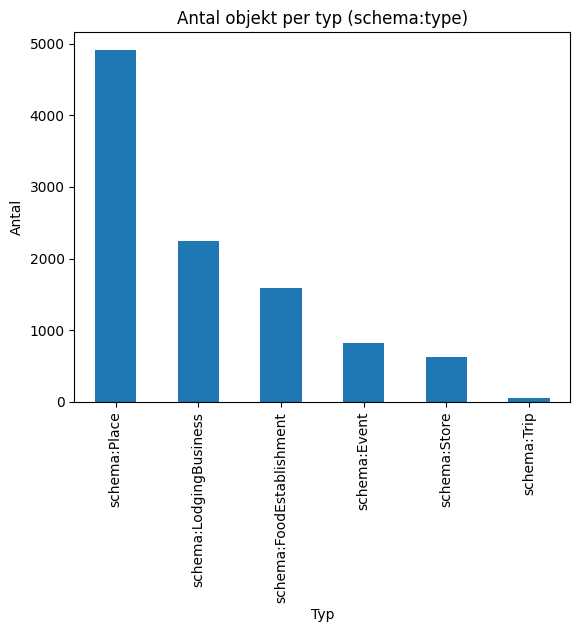

In [26]:
import matplotlib.pyplot as plt

df["type"].value_counts().plot(kind="bar")
plt.title("Antal objekt per typ (schema:type)")
plt.ylabel("Antal")
plt.xlabel("Typ")
plt.show()


In [27]:
print(f"Totalt i df: {len(df)}")
print(f"Med lat/lon: {df.dropna(subset=['latitude', 'longitude']).shape[0]}")
print(df[['name', 'latitude', 'longitude']].dropna().head())


Totalt i df: 10262
Med lat/lon: 10262
                                           name   latitude  longitude
0  Dagstur Töreboda - Sjötorp med M/S Bellevue   58.804607  14.053774
1  Dagstur Sjötorp - Töreboda med M/S Bellevue   58.837058  13.980929
2                  Julbordspaket i Motala hamn   58.533437  15.037749
3                               Julbordsweekend  58.479171  16.330662
4                      Julbordsweekend med SPA   58.479171  16.330662


In [28]:
df[["latitude", "longitude"]].dtypes


latitude     float64
longitude    float64
dtype: object

In [29]:
df.query("latitude < 54 or latitude > 70 or longitude < 10 or longitude > 25")[["name", "latitude", "longitude"]].head()


,name,latitude,longitude


In [30]:
import html as _html
from string import Template
from datetime import datetime


def add_about_box(
    m,
    issue_number: int = "222",
    map_name: str = "SAT - Visit Sweden national API",
    created_date: str | None = None,
    repo: str = "salgo60/Stockholm_Archipelago_Trail",
    collapsed: bool = True,
):
    """
    Notebook/Edge-säker About-box med string.Template ($-placeholder).
    """
    if created_date is None:
        created_date = datetime.now().strftime("%Y-%m-%d %H:%M")

    map_dom_id = m.get_name()
    box_id     = f"sat-about-{map_dom_id}"
    header_id  = f"{box_id}-hdr"
    issue_url  = f"https://github.com/{repo}/issues/{issue_number}"

    links = [
        ("▶️ Video about the ferry stop map", "https://youtu.be/k55c4ru9y5c"),
        ("SAT Dashboard", "dashboard.html"),
        ("Project repo issues", "https://github.com/salgo60/Stockholm_Archipelago_Trail/issues?q=is%3Aissue"),
        ("Trail on OSM (rel 19012437)", "https://www.openstreetmap.org/relation/19012437"),
        ("Trail on Wikicommons", "https://commons.wikimedia.org/wiki/Category:Stockholm_Archipelago_Trail"),
        ("Official page", "https://stockholmarchipelagotrail.com/"),
        ("Unofficial FB group", "https://www.facebook.com/groups/2875020699552247"),
        ("Visit Sweden", "https://traveltrade.visitsweden.com/plan/news-sweden/Stockholm-Archipelago-Trail/"),

    ]
    links_html = "".join(
        f'<div><a href="{_html.escape(u)}" target="_blank" style="text-decoration:none;">🔗 {_html.escape(t)}</a></div>'
        for t, u in links
    )
    collapsed_class = "sat-about-collapsed" if collapsed else ""

    tpl = Template(r"""
<style>
  .sat-about { position: fixed; z-index: 10000; background: rgba(255,255,255,0.97);
    border: 2px solid #666; border-radius: 10px; box-shadow: 0 2px 6px rgba(0,0,0,0.25);
    font: 12px/1.35 -apple-system, system-ui, Segoe UI, Roboto, Helvetica, Arial, sans-serif;
    pointer-events: auto; min-width: 240px; max-width: 320px; }
  .sat-about-header { cursor: pointer; padding: 8px 10px; font-weight: 700;
    display: flex; align-items: center; gap: 6px; user-select: none;
    background: rgba(248,248,248,.9); border-bottom: 1px solid #e5e7eb; }
  .sat-about-body { padding: 8px 10px 10px 10px; }
  .sat-about-collapsed .sat-about-body { display: none; }
  .sat-chevron { margin-left: auto; transition: transform .15s ease-in-out; }
  .sat-about-collapsed .sat-chevron { transform: rotate(-90deg); }
  .sat-links { margin-top: 6px; padding-top: 6px; border-top: 1px solid #e5e7eb; }
  @media (max-width: 640px) { .sat-about { font-size: 11px; min-width: 200px; max-width: 260px; } }
</style>

<div id="$box_id" class="sat-about $collapsed_class">
  <div id="$header_id" class="sat-about-header" title="Click to collapse/expand">
    <span>ℹ️ About</span>
    <span class="sat-chevron">▸</span>
  </div>
  <div class="sat-about-body">
    <div style="font-weight:700;margin-bottom:4px;">Stockholm Archipelago Trail Map</div>
    <div>Issue: <a href="$issue_url" target="_blank">#$issue_number</a>&nbsp;&nbsp; Map: $map_name</div>
    <div>Created: $created_date</div>
    <div>Latest updates: saved as <i>_latest.html</i></div>
    <div class="sat-links">$links_html</div>
  </div>
</div>

<script>
(function(){
  var mapId = "$map_dom_id";
  var boxId = "$box_id";
  var hdrId = "$header_id";
  var storageKey = "satAboutCollapsed_" + "$map_dom_id" + "_#$issue_number";

  function setCollapsed(box, collapsed) {
    var body = box.querySelector(".sat-about-body");
    if (collapsed) { box.classList.add("sat-about-collapsed"); if (body) body.style.display = "none"; }
    else { box.classList.remove("sat-about-collapsed"); if (body) body.style.display = "block"; }
    try { localStorage.setItem(storageKey, collapsed ? "1" : "0"); } catch(e) {}
  }

  function placeBox(mapEl, box) {
    var zoom = mapEl.querySelector(".leaflet-control-zoom");
    var mr   = mapEl.getBoundingClientRect();
    var top = 10, left = 10;
    if (zoom) {
      var zr = zoom.getBoundingClientRect();
      top  = (zr.bottom - mr.top) + 8;
      left = (zr.left   - mr.left) + zr.width + 8;
    }
    box.style.top  = top  + "px";
    box.style.left = left + "px";
  }

  function init(tries) {
    tries = tries || 0;
    var mapEl = document.getElementById(mapId);
    var box   = document.getElementById(boxId);
    var hdr   = document.getElementById(hdrId);
    if (!mapEl || !box || !hdr) { if (tries < 60) return setTimeout(function(){ init(tries+1); }, 120); return; }

    try {
      var stored = localStorage.getItem(storageKey);
      if (stored === "1") setCollapsed(box, true);
      if (stored === "0") setCollapsed(box, false);
    } catch(e) {}

    hdr.addEventListener("click", function(e){
      e.stopPropagation();
      var willCollapse = !box.classList.contains("sat-about-collapsed");
      setCollapsed(box, willCollapse);
    });

    function doPlace(){ placeBox(mapEl, box); }
    var placeTries = 0, iv = setInterval(function(){ doPlace(); if (++placeTries > 25) clearInterval(iv); }, 120);
    window.addEventListener("resize", doPlace);
    requestAnimationFrame(doPlace);
  }

  if (document.readyState === "loading") { document.addEventListener("DOMContentLoaded", function(){ init(0); }); }
  else { init(0); }
})();
</script>
""")

    html_snippet = tpl.substitute(
        box_id=box_id,
        header_id=header_id,
        collapsed_class=collapsed_class,
        issue_url=issue_url,
        issue_number=str(issue_number),
        map_name=_html.escape(map_name),
        created_date=_html.escape(created_date),
        links_html=links_html,
        map_dom_id=map_dom_id,
    )
    m.get_root().html.add_child(folium.Element(html_snippet))


In [32]:
import folium
from folium.plugins import MarkerCluster
from urllib.parse import quote

m = folium.Map(location=[60, 15], zoom_start=5, tiles="OpenStreetMap")

# Skapa layer som kan klickas bort
fg = folium.FeatureGroup(name="VisitSweden platser", show=True)
cluster = MarkerCluster().add_to(fg)

for _, row in df.iterrows():
    name = row.get("name", "Okänt namn")
    url = row.get("url")
    type_ = row.get("type", "").replace("schema:", "")
    lat, lon = row["latitude"], row["longitude"]

    # 🔗 Fungerande VisitSweden JSON-länk (kräver type=solr)
    query = quote(name)
    data_link = f"https://data.visitsweden.com/store/search?type=solr&query={query}&rdfFormat=application/ld+json"

    # Bygg popup
    html_popup = f"""
    <b>{name}</b><br>
    <i>{type_}</i><br>
    {f'<a href="{url}" target="_blank">🌐 www</a><br>' if url else ''}
    <a href="{data_link}" target="_blank">🧩 Databaspost (JSON)</a>
    """

    folium.Marker(
        location=[lat, lon],
        popup=folium.Popup(html_popup, max_width=300),
        icon=folium.Icon(color="blue", icon="info-sign"),
    ).add_to(cluster)

# Lägg till i kartan
fg.add_to(m)

# Gör lagret klickbart
folium.LayerControl(collapsed=False).add_to(m)



In [34]:
## Debug Trail display
import folium, json

trail_path = "SAT_full.geojson"

with open(trail_path, encoding="utf-8") as f:
    datatrailtest = json.load(f)

m = folium.Map(location=[59.1, 18.5], zoom_start=9)

folium.GeoJson(
    datatrailtest,
    style_function=lambda x: {"color": "red", "weight": 3, "fillOpacity": 0},
    tooltip=folium.GeoJsonTooltip(fields=["Labelsv", "Labelen"], aliases=["Label SV", "Label EN"]),
).add_to(m)



In [35]:
from shapely.geometry import shape
from shapely.validation import explain_validity
import json

def check_geojson_sanity(geojson_path, preview_n=5):
    """Validate and summarize a GeoJSON file before adding to a map."""
    with open(geojson_path, encoding="utf-8") as f:
        data = json.load(f)

    features = data.get("features", [])
    print(f"📦 Total features: {len(features)}\n")

    invalid, empty, non_wgs84, weird_props = [], [], [], []
    prop_keys = set()

    for f in features:
        props = f.get("properties", {})
        prop_keys.update(props.keys())
        try:
            geom = shape(f["geometry"])
            # Check geometry validity
            if not geom.is_valid:
                invalid.append((props, explain_validity(geom)))
            # Check empties
            if geom.is_empty or geom.length == 0:
                empty.append(props)
            # Detect non-lon/lat coords (e.g. projected)
            if abs(geom.bounds[0]) > 180 or abs(geom.bounds[1]) > 90:
                non_wgs84.append(props)
        except Exception as e:
            invalid.append((props, str(e)))

    # --- Summary ---
    print("🗺️  Geometry checks")
    print(f"  ✅ Valid features: {len(features) - len(invalid)}")
    print(f"  ⚠️ Invalid geometries: {len(invalid)}")
    print(f"  ⚠️ Empty/zero-length:  {len(empty)}")
    print(f"  ⚠️ Possible non-WGS84: {len(non_wgs84)}\n")

    print("🔑 Property fields found:")
    print(f"  {sorted(list(prop_keys))}\n")

    # --- Show examples if any ---
    if invalid:
        print("❌ Invalid geometry examples:")
        for p, msg in invalid[:preview_n]:
            print(f"  - {p.get('Labelsv') or p.get('etapp') or 'Unnamed'} → {msg}")
        print()

    if empty:
        print("⚠️ Empty feature examples:")
        for p in empty[:preview_n]:
            print(f"  - {p.get('Labelsv') or p.get('etapp') or 'Unnamed'}")
        print()

    if non_wgs84:
        print("🌍 Possible non-WGS84 coordinate examples:")
        for p in non_wgs84[:preview_n]:
            print(f"  - {p.get('Labelsv') or p.get('etapp') or 'Unnamed'}")
        print()

    print("✅ Check complete.\n")


In [36]:
check_geojson_sanity("SAT_full.geojson")

📦 Total features: 790

🗺️  Geometry checks
  ✅ Valid features: 790
  ⚠️ Invalid geometries: 0
  ⚠️ Empty/zero-length:  0
  ⚠️ Possible non-WGS84: 0

🔑 Property fields found:
  ['Labelen', 'Labelsv', 'OSM_REL', 'P1401', 'P373', 'P968', 'QID', 'website_en', 'website_sv']

✅ Check complete.



In [37]:
# check coordinates 
from shapely.geometry import shape
first_geom = shape(datatrailtest["features"][0]["geometry"])
print(first_geom.bounds)


(19.1077486, 59.8511841, 19.1084972, 59.8513033)


In [38]:
print("Number of features:", len(datatrailtest.get("features", [])))
for f in datatrailtest["features"][:3]:
    print(f["geometry"]["type"], f["properties"].get("Labelsv"))

Number of features: 790
LineString SAT Arholma
LineString SAT Arholma
LineString SAT Arholma


In [39]:
import folium
from folium.plugins import MarkerCluster
from urllib.parse import quote
from datetime import datetime
import json, os, shutil, re
from pathlib import Path

# ---------------- Helper functions ----------------
def _to_latest_name(filename: str | Path) -> Path:
    p = Path(filename)
    stem = p.stem
    new_stem = re.sub(r'_(?:20\d{6})(?:_\d{4})?$', '', stem)
    return p.with_name(new_stem + "_latest.html")

def save_with_latest(map_object, filename: str | Path):
    map_object.save(str(filename))
    latest_path = _to_latest_name(filename)
    shutil.copyfile(filename, latest_path)
    print(f"✅ Saved: {filename}\n✅ Updated alias: {latest_path}")

# ---------------- Trail popup ----------------
def make_trail_popup(props: dict) -> str:
    # Handle missing fields safely
    name = (
        props.get("Labelen")
        or props.get("Labelsv")
        or props.get("etapp")
        or "SAT Trail"
    )
    web_sv = props.get("website_sv")
    web_en = props.get("website_en")
    commons_cat = props.get("P373")
    source = props.get("source", "Wikidata/Commons")

    links = []
    if web_sv:
        links.append(f'🇸🇪 <a href="{web_sv}" target="_blank">Official Swedish page</a>')
    if web_en:
        links.append(f'🇬🇧 <a href="{web_en}" target="_blank">Official English page</a>')
    links.append('▶️ <a href="https://youtu.be/CPgDPhvHrcQ" target="_blank">video about the map</a>')

    commons_links = ""
    if commons_cat:
        cat_enc = commons_cat.replace(" ", "_")
        commons_url = f"https://commons.wikimedia.org/wiki/Category:{cat_enc}"
        map_url = f"https://wikimap.toolforge.org/?cat={cat_enc}&subcats=true&subcatdepth=3&cluster=false"
        commons_links = f"""
        <p>
        📸 <a href="{commons_url}" target="_blank">Wikicommons pictures</a> /
        🗺️ <a href="{map_url}" target="_blank">Map</a>
        </p>
        """

    return f"""
    <h3>{name}</h3>
    <p>{"<br>".join(links)}</p>
    {commons_links}
    <p><em>Source: {source}</em></p>
    """

# ---------------- Icon setup per type ----------------
ICON_MAP = {
    "schema:Place":           ("green", "map-marker"),
    "schema:LodgingBusiness": ("cadetblue", "bed"),
    "schema:FoodEstablishment": ("orange", "cutlery"),
    "schema:Event":           ("purple", "star"),
    "schema:Store":           ("darkblue", "shopping-cart"),
    "schema:Trip":            ("red", "flag"),
}

# ---------------- Build map ----------------
def build_visitsweden_map(df, trail_path="SAT_full.geojson", trail_color="red", out_dir="output"):
    m = folium.Map(location=[60, 15], zoom_start=5, tiles="OpenStreetMap")

    # --- VisitSweden layers ---
    for t, (color, icon) in ICON_MAP.items():
        type_df = df[df["type"] == t]
        if type_df.empty:
            continue

        type_name = t.replace("schema:", "")
        fg = folium.FeatureGroup(name=f"{type_name} ({len(type_df)})", show=(t != "schema:Event"))
        cluster = MarkerCluster().add_to(fg)

        for _, row in type_df.iterrows():
            name = row.get("name", "Okänt namn")
            url = row.get("url")
            lat, lon = row["latitude"], row["longitude"]

            query = quote(name)
            data_link = f"https://data.visitsweden.com/store/search?type=solr&query={query}&rdfFormat=application/ld+json"

            popup_html = f"""
            <b>{name}</b><br>
            <i>{type_name}</i><br>
            {f'<a href="{url}" target="_blank">🌐 www</a><br>' if url else ''}
            <a href="{data_link}" target="_blank">🧩 Databaspost (JSON)</a>
            """

            folium.Marker(
                location=[lat, lon],
                popup=folium.Popup(popup_html, max_width=300),
                icon=folium.Icon(color=color, icon=icon, prefix="fa"),
            ).add_to(cluster)

        fg.add_to(m)
    # --- Trail layer (safe working version, no popup) ---
    if trail_path and os.path.exists(trail_path):
        fg_trail = folium.FeatureGroup(name="SAT Trail", show=True)
        with open(trail_path, "r", encoding="utf-8") as f:
            trail_gj = json.load(f)
    
        # detect available fields safely
        available_fields = set()
        for f in trail_gj.get("features", []):
            available_fields.update(f.get("properties", {}).keys())
    
        tooltip_candidates = ["Labelsv", "Labelen", "etapp"]
        tooltip_fields = [f for f in tooltip_candidates if f in available_fields]
    
        print(f"🧭 Tooltip fields detected: {tooltip_fields}")
    
        folium.GeoJson(
            trail_gj,
            name="SAT Trail",
            style_function=lambda x: {"color": trail_color, "weight": 3, "fillOpacity": 0},
            tooltip=folium.GeoJsonTooltip(
                fields=tooltip_fields,
                aliases=[f.title() for f in tooltip_fields],
                sticky=False
            ) if tooltip_fields else None,
        ).add_to(fg_trail)
    
        fg_trail.add_to(m)
        print(f"✅ Added {len(trail_gj.get('features', []))} trail segments")
    else:
        print(f"⚠️ Trail file not found: {trail_path}")
        
    folium.LayerControl(collapsed=False).add_to(m)

    add_about_box(m)

    # --- Save map with timestamp ---
    os.makedirs(out_dir, exist_ok=True)
    timestamp = datetime.now().strftime("%Y%m%d_%H%M")
    map_file = Path(out_dir) / f"222_visitsweden_with_trail_{timestamp}.html"
    save_with_latest(m, map_file)

    return m


In [40]:
m = build_visitsweden_map(df)

🧭 Tooltip fields detected: ['Labelsv', 'Labelen']
✅ Added 790 trail segments
✅ Saved: output/222_visitsweden_with_trail_20251105_0532.html
✅ Updated alias: output/222_visitsweden_with_trail_latest.html


In [42]:
m


In [43]:
from datetime import datetime
# End timer and calculate duration
end_time = time.time()
elapsed_time = end_time - start_time# Bygg audit-lager för den här etappen
now = datetime.now()
# Print current date and total time
print("Date:", datetime.now().strftime("%Y-%m-%d %H:%M:%S"))
minutes, seconds = divmod(elapsed_time, 60)
print("Total time elapsed: {:02.0f} minutes {:05.2f} seconds".format(minutes, seconds))


Date: 2025-11-05 05:33:40
Total time elapsed: 04 minutes 39.30 seconds
